In [1]:
import os
import zipfile 
import shutil
import numpy as np
import os,os.path,sys
import pandas as pd
import multiprocessing
from zipfile import ZipFile
from datetime import timedelta, datetime
import seaborn as sns
import matplotlib.pyplot as plt
from sklearn.preprocessing import MinMaxScaler
from scipy import stats
from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_squared_error


# Data Preprocessing

In [3]:
PATH="CE888/working"
data = pd.read_csv(os.path.join(PATH, 'merged_data_label.csv'), dtype={'id': str})
#data

# Data Cleaning

In [4]:
# drop the duplicated data
data=data.drop_duplicates(subset=None, keep='first', inplace=False, ignore_index=False)
#len(data)
data=data.dropna(axis=0, how='any') #drop the null data 
data=data.drop(columns=['HR_y'])  #dropping the HR_Y columns as HR_X and why are the two duplicated columns so one was removed
data

,X,Y,Z,EDA,TEMP,datetime,label,id,HR_x,BVP,Duration
0,-13.0,-61.0,5.0,6.769995,31.17,2020-07-08 14:03:00.000000000,2.0,15,99.43,-0.0,00:11:00
1,-20.0,-69.0,-3.0,6.769995,31.17,2020-07-08 14:03:00.031249920,2.0,15,99.43,-0.0,00:11:00
2,-31.0,-78.0,-15.0,6.769995,31.17,2020-07-08 14:03:00.062500096,2.0,15,99.43,-0.0,00:11:00
3,-47.0,-65.0,-38.0,6.769995,31.17,2020-07-08 14:03:00.093750016,2.0,15,99.43,-0.0,00:11:00
4,-67.0,-57.0,-53.0,6.769995,31.17,2020-07-08 14:03:00.124999936,2.0,15,99.43,-0.0,00:11:00
...,...,...,...,...,...,...,...,...,...,...,...
11781686,-16.0,-56.0,24.0,3.386070,33.77,2020-07-23 17:28:59.875000064,2.0,F5,88.37,-0.0,00:07:00
11781687,-8.0,-50.0,27.0,3.386070,33.77,2020-07-23 17:28:59.906249984,2.0,F5,88.37,-0.0,00:07:00
11781688,-28.0,-36.0,28.0,3.386070,33.77,2020-07-23 17:28:59.937499904,2.0,F5,88.37,-0.0,00:07:00
11781689,-29.0,-29.0,30.0,3.386070,33.77,2020-07-23 17:28:59.968750080,2.0,F5,88.37,-0.0,00:07:00


# Data Sampling 

In [5]:
sample = data.sample(frac=0.02) #taking out the sample from the whold data due to the memory and time consumption as total data is around 12 million.
sample

,X,Y,Z,EDA,TEMP,datetime,label,id,HR_x,BVP,Duration
5295897,-65.0,6.0,-5.0,3.784668,34.25,2020-12-10 12:53:55.062500096,2.0,83,75.02,-0.00,01:25:00
4407216,2.0,52.0,11.0,0.057650,33.23,2020-11-04 21:19:04.218749952,2.0,7E,86.97,-0.00,00:26:00
6792596,-38.0,5.0,51.0,3.830120,33.53,2020-07-07 12:52:28.656250112,2.0,94,81.73,-0.00,00:18:00
11103422,51.0,2.0,37.0,0.157585,30.91,2020-11-11 17:14:44.968750080,2.0,EG,82.27,-0.00,01:46:00
805603,-29.0,3.0,57.0,0.166800,29.33,2020-06-24 14:28:34.624999936,2.0,5C,111.02,-0.00,01:16:00
...,...,...,...,...,...,...,...,...,...,...,...
3084079,-40.0,15.0,-8.0,3.360645,34.77,2020-04-23 15:04:18.187500032,2.0,7A,88.05,-0.00,01:34:00
11244266,46.0,0.0,40.0,0.247252,31.31,2020-12-09 17:16:06.312499968,2.0,EG,84.63,-0.00,00:20:00
2806559,-47.0,-7.0,44.0,6.905632,34.81,2020-04-19 14:24:45.781250048,2.0,7A,83.47,-0.00,01:00:00
5955429,-32.0,22.0,48.0,2.278333,31.95,2020-07-17 14:21:25.000000000,2.0,8B,84.83,-0.00,00:16:00


In [6]:
features=sample[['id','datetime','X','Y','Z','EDA','TEMP','HR_x','BVP','Duration']]  #featue columns
features

,id,datetime,X,Y,Z,EDA,TEMP,HR_x,BVP,Duration
5295897,83,2020-12-10 12:53:55.062500096,-65.0,6.0,-5.0,3.784668,34.25,75.02,-0.00,01:25:00
4407216,7E,2020-11-04 21:19:04.218749952,2.0,52.0,11.0,0.057650,33.23,86.97,-0.00,00:26:00
6792596,94,2020-07-07 12:52:28.656250112,-38.0,5.0,51.0,3.830120,33.53,81.73,-0.00,00:18:00
11103422,EG,2020-11-11 17:14:44.968750080,51.0,2.0,37.0,0.157585,30.91,82.27,-0.00,01:46:00
805603,5C,2020-06-24 14:28:34.624999936,-29.0,3.0,57.0,0.166800,29.33,111.02,-0.00,01:16:00
...,...,...,...,...,...,...,...,...,...,...
3084079,7A,2020-04-23 15:04:18.187500032,-40.0,15.0,-8.0,3.360645,34.77,88.05,-0.00,01:34:00
11244266,EG,2020-12-09 17:16:06.312499968,46.0,0.0,40.0,0.247252,31.31,84.63,-0.00,00:20:00
2806559,7A,2020-04-19 14:24:45.781250048,-47.0,-7.0,44.0,6.905632,34.81,83.47,-0.00,01:00:00
5955429,8B,2020-07-17 14:21:25.000000000,-32.0,22.0,48.0,2.278333,31.95,84.83,-0.00,00:16:00


In [7]:
labels=pd.DataFrame()
labels['Stress Level']=sample[['label']]  #label data 
labels

,Stress Level
5295897,2.0
4407216,2.0
6792596,2.0
11103422,2.0
805603,2.0
...,...
3084079,2.0
11244266,2.0
2806559,2.0
5955429,2.0


# Feature Extraction

In [8]:
#function to calcuate the statistical features for each individual single four statistical features has been calculate based on min, max, mean and standard deviation value of corresponding signals
def statisticalFeatures(data):
  dataMin=min(data)   
  dataMax=max(data)
  dataMean=data.mean()
  dataSTD=data.std()

  return dataMin, dataMax, dataMean, dataSTD


In [9]:
#Adding statistical features data frames in features
features['EDA_min'],features['EDA_max'],features['EDA_mean'],features['EDA_std']=0,0,0,0
features['Temp_min'],features['Temp_max'],features['Temp_mean'],features['Temp_std'] = 0,0,0,0
features['HR_X_min'],features['HR_X_max'],features['HR_X_mean'],features['HR_X_std'] = 0,0,0,0
features['BVP_min'],features['BVP_max'],features['BVP_mean'],features['BVP_std'] = 0,0,0,0

features

,id,datetime,X,Y,Z,EDA,TEMP,HR_x,BVP,Duration,...,Temp_mean,Temp_std,HR_X_min,HR_X_max,HR_X_mean,HR_X_std,BVP_min,BVP_max,BVP_mean,BVP_std
5295897,83,2020-12-10 12:53:55.062500096,-65.0,6.0,-5.0,3.784668,34.25,75.02,-0.00,01:25:00,...,0,0,0,0,0,0,0,0,0,0
4407216,7E,2020-11-04 21:19:04.218749952,2.0,52.0,11.0,0.057650,33.23,86.97,-0.00,00:26:00,...,0,0,0,0,0,0,0,0,0,0
6792596,94,2020-07-07 12:52:28.656250112,-38.0,5.0,51.0,3.830120,33.53,81.73,-0.00,00:18:00,...,0,0,0,0,0,0,0,0,0,0
11103422,EG,2020-11-11 17:14:44.968750080,51.0,2.0,37.0,0.157585,30.91,82.27,-0.00,01:46:00,...,0,0,0,0,0,0,0,0,0,0
805603,5C,2020-06-24 14:28:34.624999936,-29.0,3.0,57.0,0.166800,29.33,111.02,-0.00,01:16:00,...,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3084079,7A,2020-04-23 15:04:18.187500032,-40.0,15.0,-8.0,3.360645,34.77,88.05,-0.00,01:34:00,...,0,0,0,0,0,0,0,0,0,0
11244266,EG,2020-12-09 17:16:06.312499968,46.0,0.0,40.0,0.247252,31.31,84.63,-0.00,00:20:00,...,0,0,0,0,0,0,0,0,0,0
2806559,7A,2020-04-19 14:24:45.781250048,-47.0,-7.0,44.0,6.905632,34.81,83.47,-0.00,01:00:00,...,0,0,0,0,0,0,0,0,0,0
5955429,8B,2020-07-17 14:21:25.000000000,-32.0,22.0,48.0,2.278333,31.95,84.83,-0.00,00:16:00,...,0,0,0,0,0,0,0,0,0,0


In [10]:
#function to store the statistical features in the data frame 
def Feature_Extraction(features,filename):
  PATH="CE888/working"
  for i in range(0,len(features['EDA'].values),19):
    start=i
    end=start+19
    features['EDA_min'][start:end],features['EDA_max'][start:end],features['EDA_mean'][start:end],features['EDA_std'][start:end]=statisticalFeatures(features['EDA'][start:end])  #calling and storing statistical feature function
    features['Temp_min'][start:end],features['Temp_max'][start:end],features['Temp_mean'][start:end],features['Temp_std'][start:end] = statisticalFeatures(features['TEMP'][start:end])
    features['HR_X_min'][start:end],features['HR_X_max'][start:end],features['HR_X_mean'][start:end],features['HR_X_std'][start:end] = statisticalFeatures(features['HR_x'][start:end])
    features['BVP_min'][start:end],features['BVP_max'][start:end],features['BVP_mean'][start:end],features['BVP_std'][start:end] = statisticalFeatures(features['BVP'][start:end])
    

  #features=features.iloc[0:233944,]
  #features.to_csv(os.path.join(PATH, filename),index=False)  # storing all the features in csv file
  return features

features=Feature_Extraction(features,'Train_Data.csv')
features

<ipython-input-10-c2f1ddd44ff8>:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  features['EDA_min'][start:end],features['EDA_max'][start:end],features['EDA_mean'][start:end],features['EDA_std'][start:end]=statisticalFeatures(features['EDA'][start:end])  #calling and storing statistical feature function
<ipython-input-10-c2f1ddd44ff8>:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  features['Temp_min'][start:end],features['Temp_max'][start:end],features['Temp_mean'][start:end],features['Temp_std'][start:end] = statisticalFeatures(features['TEMP'][start:end])
<ipython-input-10-c2f1ddd44ff8>:9: SettingWithCopyWarning: 


,id,datetime,X,Y,Z,EDA,TEMP,HR_x,BVP,Duration,...,Temp_mean,Temp_std,HR_X_min,HR_X_max,HR_X_mean,HR_X_std,BVP_min,BVP_max,BVP_mean,BVP_std
5295897,83,2020-12-10 12:53:55.062500096,-65.0,6.0,-5.0,3.784668,34.25,75.02,-0.00,01:25:00,...,32.170526,2.079486,64.07,111.02,87.632105,11.774518,0.00,4.39,0.231053,1.007135
4407216,7E,2020-11-04 21:19:04.218749952,2.0,52.0,11.0,0.057650,33.23,86.97,-0.00,00:26:00,...,32.170526,2.079486,64.07,111.02,87.632105,11.774518,0.00,4.39,0.231053,1.007135
6792596,94,2020-07-07 12:52:28.656250112,-38.0,5.0,51.0,3.830120,33.53,81.73,-0.00,00:18:00,...,32.170526,2.079486,64.07,111.02,87.632105,11.774518,0.00,4.39,0.231053,1.007135
11103422,EG,2020-11-11 17:14:44.968750080,51.0,2.0,37.0,0.157585,30.91,82.27,-0.00,01:46:00,...,32.170526,2.079486,64.07,111.02,87.632105,11.774518,0.00,4.39,0.231053,1.007135
805603,5C,2020-06-24 14:28:34.624999936,-29.0,3.0,57.0,0.166800,29.33,111.02,-0.00,01:16:00,...,32.170526,2.079486,64.07,111.02,87.632105,11.774518,0.00,4.39,0.231053,1.007135
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3084079,7A,2020-04-23 15:04:18.187500032,-40.0,15.0,-8.0,3.360645,34.77,88.05,-0.00,01:34:00,...,32.134375,2.352253,72.62,119.88,88.252500,14.072610,-51.79,148.62,6.051875,40.153128
11244266,EG,2020-12-09 17:16:06.312499968,46.0,0.0,40.0,0.247252,31.31,84.63,-0.00,00:20:00,...,32.134375,2.352253,72.62,119.88,88.252500,14.072610,-51.79,148.62,6.051875,40.153128
2806559,7A,2020-04-19 14:24:45.781250048,-47.0,-7.0,44.0,6.905632,34.81,83.47,-0.00,01:00:00,...,32.134375,2.352253,72.62,119.88,88.252500,14.072610,-51.79,148.62,6.051875,40.153128
5955429,8B,2020-07-17 14:21:25.000000000,-32.0,22.0,48.0,2.278333,31.95,84.83,-0.00,00:16:00,...,32.134375,2.352253,72.62,119.88,88.252500,14.072610,-51.79,148.62,6.051875,40.153128


# Features Correlation Plots 

<ipython-input-17-d245e7e89a02>:2: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  correlation = features.corr()


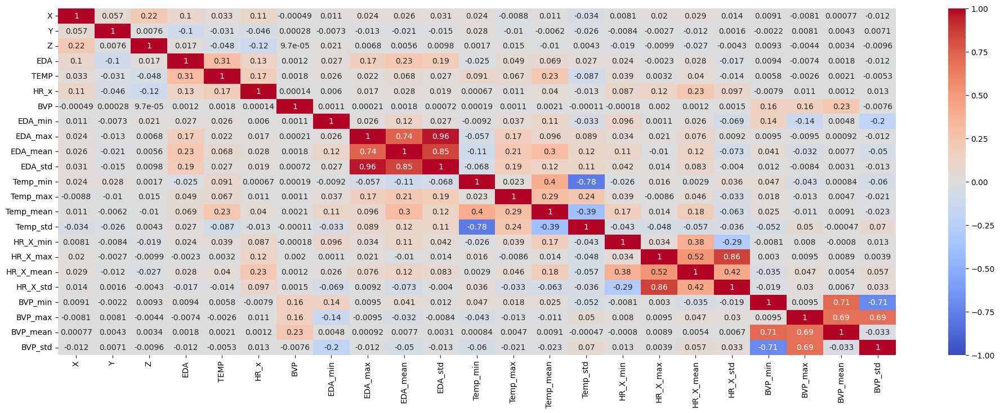

In [ ]:
#generating a features correlation plot to find out the correlated features
correlation = features.corr()  
#print(correlation)
plt.figure(figsize=(24, 8))
sns.heatmap(correlation, cmap='coolwarm', vmin=-1, vmax=1, annot=True)
plt.show()


# Features histogram plots

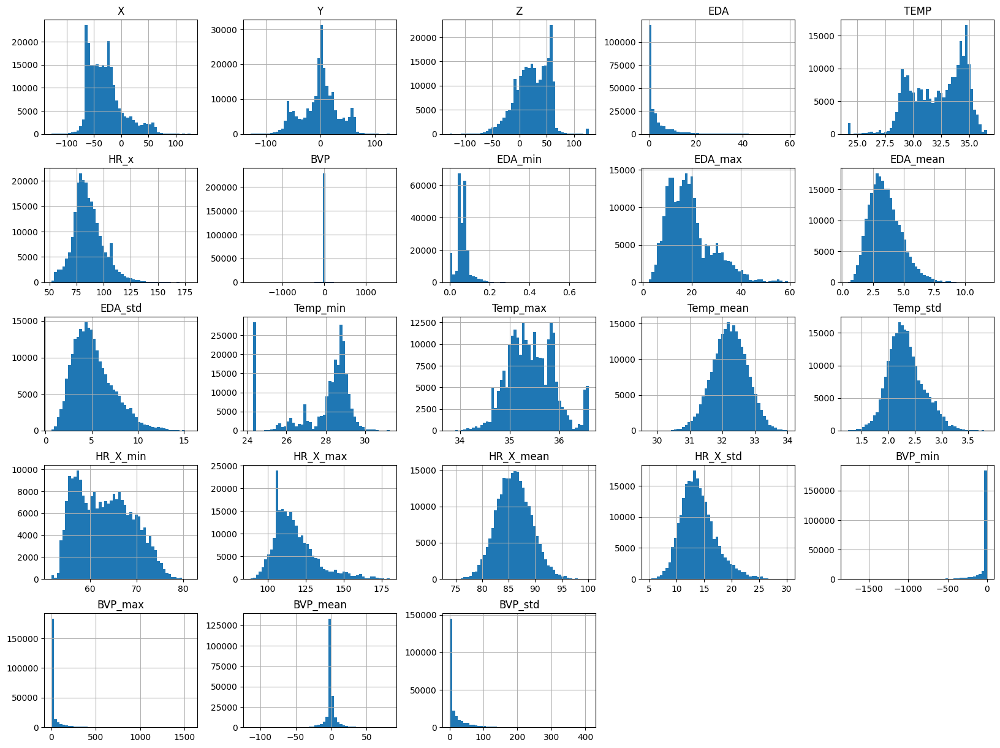

In [ ]:
histograms = features.hist(bins=50, figsize=(20,15))  #all features histograms has been generated to visualised each variables
plt.show()

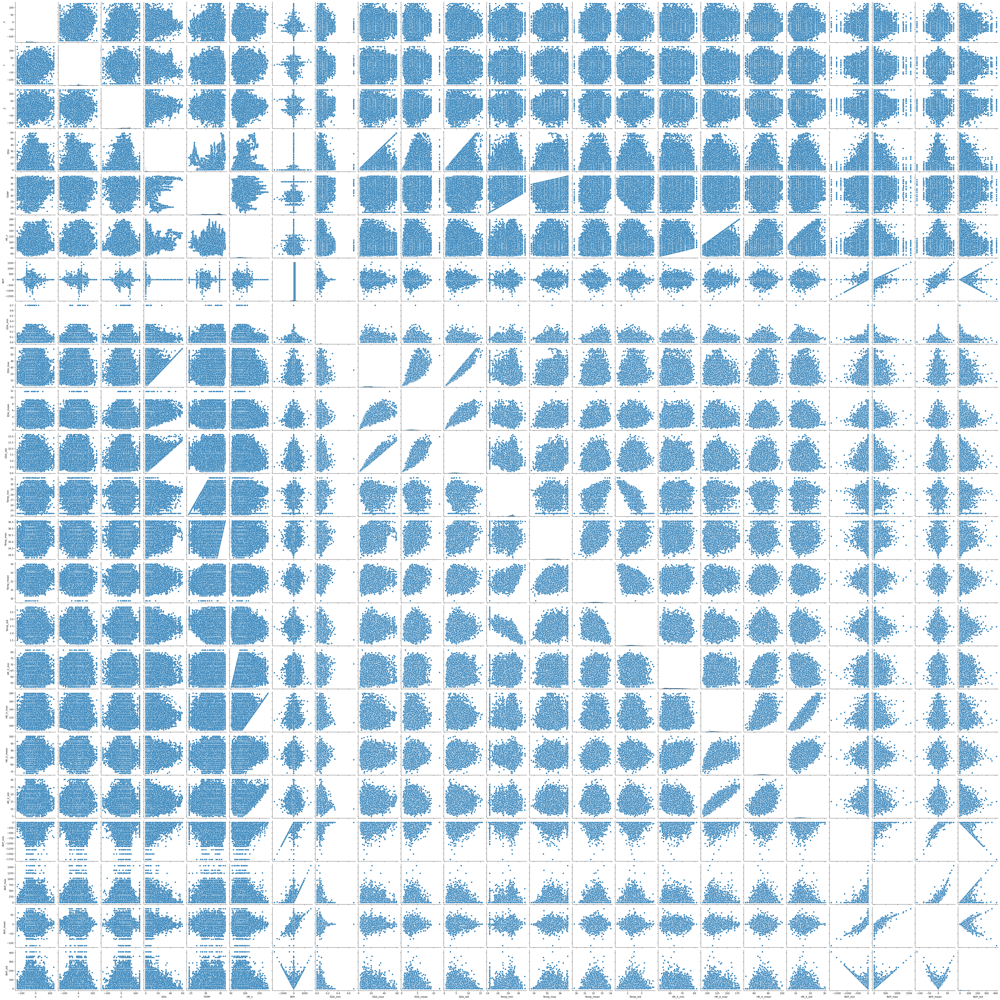

In [ ]:
cols=['X','Y','Z','EDA','TEMP','HR_x','BVP','EDA_min', 'EDA_max', 'EDA_mean', 'EDA_std', 'Temp_min', 'Temp_max','Temp_mean', 'Temp_std', 'HR_X_min', 'HR_X_max', 'HR_X_mean','HR_X_std', 'BVP_min', 'BVP_max', 'BVP_mean', 'BVP_std']
scatter = sns.pairplot(features[cols])  #all features scattered plot has been generated to visualised each variables

# Timeseries Plot

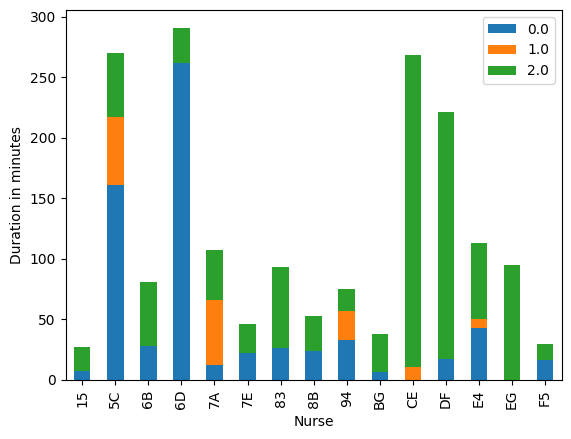

In [35]:
#Time series plot between nurses and their stress level duration in time duration
x=sample['id']
y=pd.to_timedelta(sample['Duration']).dt.total_seconds()/60
z=sample['label'] 

df=pd.concat([x,y,z], axis=1)
grouped = df.groupby(["id", "label"]).mean().reset_index()

pivoted = grouped.pivot(index="id", columns="label", values="Duration")

pivoted.plot(kind="bar", stacked=True)

plt.xlabel("Nurse")
plt.ylabel("Duration in minutes")

# Add a legend
plt.legend()

plt.show()

<Axes: xlabel='id', ylabel='EDA'>

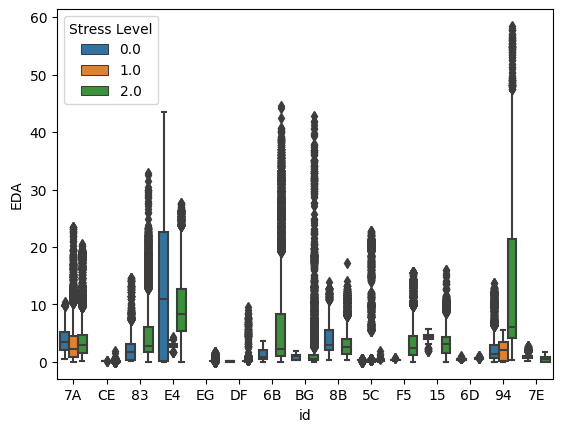

In [36]:
#Plot to analze the stress level between nurses based on EDA signal
sns.boxplot(x = sample['id'],
            y = sample['EDA'],
            hue = labels['Stress Level'])

<Axes: xlabel='id', ylabel='HR_x'>

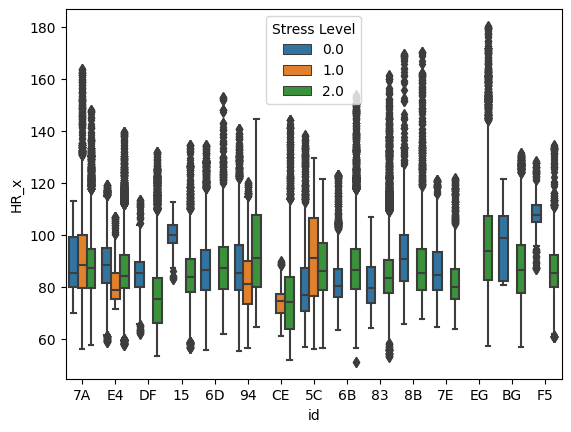

In [ ]:
#Plot to analze the stress level between nurses based on HR signal
sns.boxplot(x = sample['id'],
            y = sample['HR_x'],
            hue = labels['Stress Level'])

<Axes: xlabel='id', ylabel='BVP'>

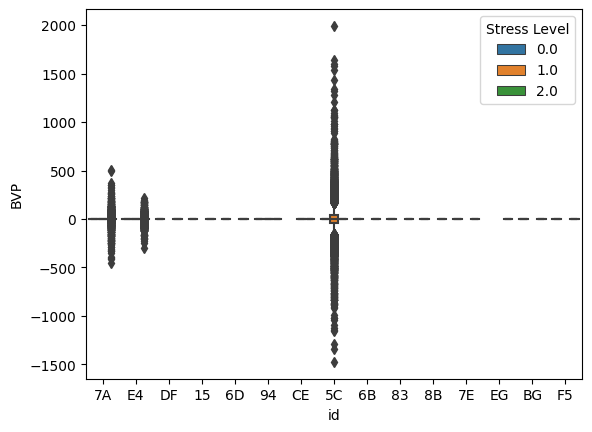

In [ ]:
#Plot to analze the stress level between nurses based on BVP signal
sns.boxplot(x = sample['id'],
            y = sample['BVP'],
            hue = labels['Stress Level'])


<Axes: xlabel='id', ylabel='TEMP'>

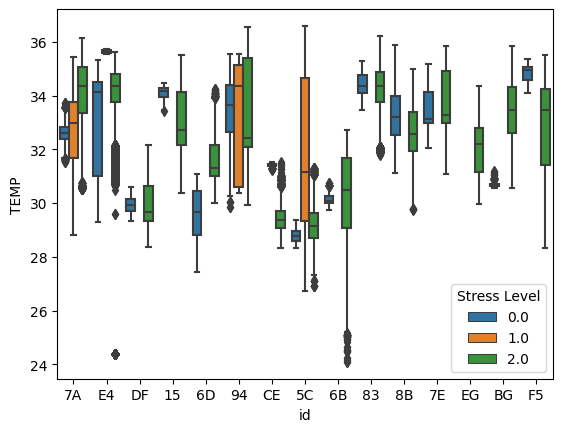

In [ ]:
#Plot to analze the stress level between nurses based on TEMP signal
sns.boxplot(x = sample['id'],
            y = sample['TEMP'],
            hue = labels['Stress Level'])


# Data Standardization

In [11]:
#Normalizing the data and preparing it for the model training
def Standardization(features_set):
  
  feature = pd.DataFrame(features_set[['X','Y','Z','EDA','TEMP','HR_x','BVP','EDA_min', 'EDA_max', 'EDA_mean', 'EDA_std', 'Temp_min', 'Temp_max','Temp_mean', 'Temp_std', 'HR_X_min', 'HR_X_max', 'HR_X_mean','HR_X_std', 'BVP_min', 'BVP_max', 'BVP_mean', 'BVP_std']])
  # define standard scaler
  scaler = MinMaxScaler()
  scaler.fit(feature)
  # transform data
  feature = scaler.fit_transform(feature)
  feature = pd.DataFrame(feature,columns=['X','Y','Z','EDA','TEMP','HR_x','BVP','EDA_min', 'EDA_max', 'EDA_mean', 'EDA_std', 'Temp_min', 'Temp_max','Temp_mean', 'Temp_std', 'HR_X_min', 'HR_X_max', 'HR_X_mean','HR_X_std', 'BVP_min', 'BVP_max', 'BVP_mean', 'BVP_std'])
  return feature

In [12]:
features_copy=features.copy()
#removing the not needed columns for training
features=features.drop(columns='datetime')
features=features.drop(columns='Duration')
features=features.drop(columns='id')
#features
feature = Standardization(features) #calling standardization function on features
feature

#Bar plots shows the huge number of outliers so removing them based of the quanitile range of 0.01 to 0.99.
for col in features:
  q_low = feature[col].quantile(0.01)
  q_hi  = feature[col].quantile(0.99)
  feature_filters = feature[(feature[col] < q_hi) & (feature[col] > q_low)]
  
index=feature_filters.index #storing index of the remaining data after removing the outliers 
feature_filters



,X,Y,Z,EDA,TEMP,HR_x,BVP,EDA_min,EDA_max,EDA_mean,...,Temp_mean,Temp_std,HR_X_min,HR_X_max,HR_X_mean,HR_X_std,BVP_min,BVP_max,BVP_mean,BVP_std
0,0.247059,0.525490,0.482353,0.063677,0.811594,0.181564,0.601108,0.09967,0.124623,0.101559,...,0.497872,0.374739,0.409316,0.264896,0.500318,0.247190,1.000000,0.002729,0.579865,0.001795
1,0.509804,0.705882,0.545098,0.000970,0.729469,0.274524,0.601108,0.09967,0.124623,0.101559,...,0.497872,0.374739,0.409316,0.264896,0.500318,0.247190,1.000000,0.002729,0.579865,0.001795
2,0.352941,0.521569,0.701961,0.064442,0.753623,0.233761,0.601108,0.09967,0.124623,0.101559,...,0.497872,0.374739,0.409316,0.264896,0.500318,0.247190,1.000000,0.002729,0.579865,0.001795
3,0.701961,0.509804,0.647059,0.002651,0.542673,0.237962,0.601108,0.09967,0.124623,0.101559,...,0.497872,0.374739,0.409316,0.264896,0.500318,0.247190,1.000000,0.002729,0.579865,0.001795
4,0.388235,0.513725,0.725490,0.002806,0.415459,0.461610,0.601108,0.09967,0.124623,0.101559,...,0.497872,0.374739,0.409316,0.264896,0.500318,0.247190,1.000000,0.002729,0.579865,0.001795
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
233939,0.345098,0.560784,0.470588,0.056543,0.853462,0.282925,0.601108,0.09967,0.177857,0.219430,...,0.489273,0.469815,0.691774,0.359002,0.522376,0.340995,0.978633,0.092399,0.608832,0.071580
233940,0.682353,0.501961,0.658824,0.004160,0.574879,0.256320,0.601108,0.09967,0.177857,0.219430,...,0.489273,0.469815,0.691774,0.359002,0.522376,0.340995,0.978633,0.092399,0.608832,0.071580
233941,0.317647,0.474510,0.674510,0.116188,0.856683,0.247297,0.601108,0.09967,0.177857,0.219430,...,0.489273,0.469815,0.691774,0.359002,0.522376,0.340995,0.978633,0.092399,0.608832,0.071580
233942,0.376471,0.588235,0.690196,0.038333,0.626409,0.257876,0.601108,0.09967,0.177857,0.219430,...,0.489273,0.469815,0.691774,0.359002,0.522376,0.340995,0.978633,0.092399,0.608832,0.071580


In [13]:
#getting the features after removing outliers based on the stored indexes
a=np.array(index) 

feature=feature.take(a)
feature

,X,Y,Z,EDA,TEMP,HR_x,BVP,EDA_min,EDA_max,EDA_mean,...,Temp_mean,Temp_std,HR_X_min,HR_X_max,HR_X_mean,HR_X_std,BVP_min,BVP_max,BVP_mean,BVP_std
0,0.247059,0.525490,0.482353,0.063677,0.811594,0.181564,0.601108,0.09967,0.124623,0.101559,...,0.497872,0.374739,0.409316,0.264896,0.500318,0.247190,1.000000,0.002729,0.579865,0.001795
1,0.509804,0.705882,0.545098,0.000970,0.729469,0.274524,0.601108,0.09967,0.124623,0.101559,...,0.497872,0.374739,0.409316,0.264896,0.500318,0.247190,1.000000,0.002729,0.579865,0.001795
2,0.352941,0.521569,0.701961,0.064442,0.753623,0.233761,0.601108,0.09967,0.124623,0.101559,...,0.497872,0.374739,0.409316,0.264896,0.500318,0.247190,1.000000,0.002729,0.579865,0.001795
3,0.701961,0.509804,0.647059,0.002651,0.542673,0.237962,0.601108,0.09967,0.124623,0.101559,...,0.497872,0.374739,0.409316,0.264896,0.500318,0.247190,1.000000,0.002729,0.579865,0.001795
4,0.388235,0.513725,0.725490,0.002806,0.415459,0.461610,0.601108,0.09967,0.124623,0.101559,...,0.497872,0.374739,0.409316,0.264896,0.500318,0.247190,1.000000,0.002729,0.579865,0.001795
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
233939,0.345098,0.560784,0.470588,0.056543,0.853462,0.282925,0.601108,0.09967,0.177857,0.219430,...,0.489273,0.469815,0.691774,0.359002,0.522376,0.340995,0.978633,0.092399,0.608832,0.071580
233940,0.682353,0.501961,0.658824,0.004160,0.574879,0.256320,0.601108,0.09967,0.177857,0.219430,...,0.489273,0.469815,0.691774,0.359002,0.522376,0.340995,0.978633,0.092399,0.608832,0.071580
233941,0.317647,0.474510,0.674510,0.116188,0.856683,0.247297,0.601108,0.09967,0.177857,0.219430,...,0.489273,0.469815,0.691774,0.359002,0.522376,0.340995,0.978633,0.092399,0.608832,0.071580
233942,0.376471,0.588235,0.690196,0.038333,0.626409,0.257876,0.601108,0.09967,0.177857,0.219430,...,0.489273,0.469815,0.691774,0.359002,0.522376,0.340995,0.978633,0.092399,0.608832,0.071580


In [14]:
#getting the labels for corresponding features after removing outliers based on the stored indexes
label=labels.take(a)
label

,Stress Level
5295897,2.0
4407216,2.0
6792596,2.0
11103422,2.0
805603,2.0
...,...
3084079,2.0
11244266,2.0
2806559,2.0
5955429,2.0


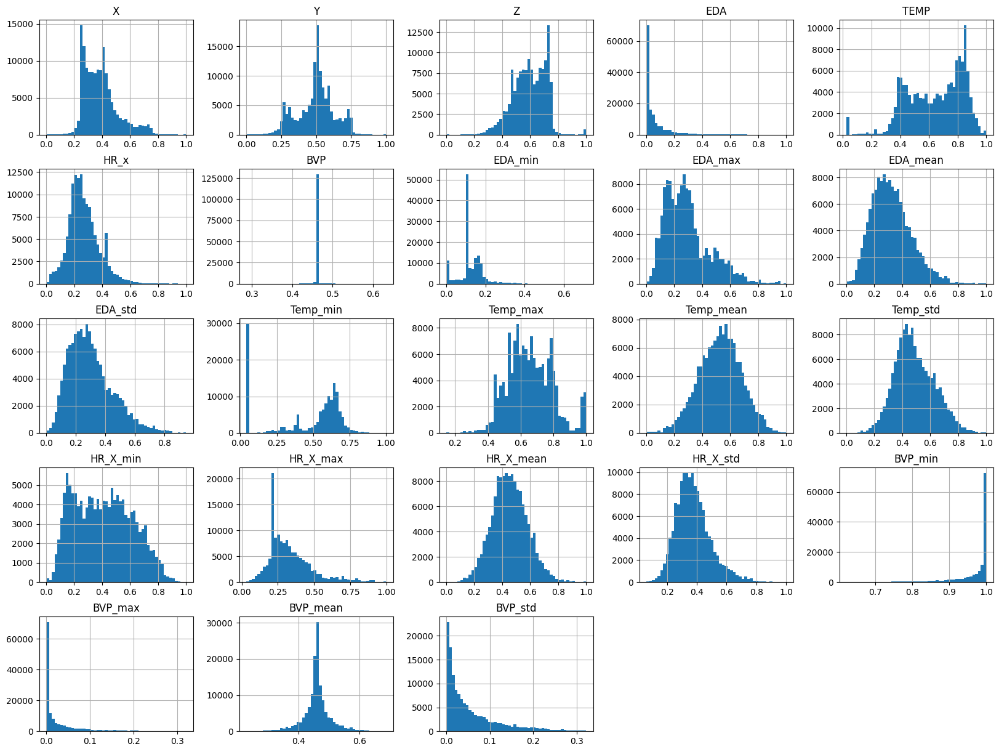

In [ ]:
#generating histogram on normalised and outliers free features
histograms = feature.hist(bins=50, figsize=(20,15))
plt.show()

# Training Testing Data Spliting

In [15]:
#splitting the dataset between training and testing (used for validating the model) Training and validation ratio is 70:30
x=feature[['X','Y','Z','EDA','TEMP','HR_x','BVP','EDA_min', 'EDA_max', 'EDA_mean', 'EDA_std', 'Temp_min', 'Temp_max','Temp_mean', 'Temp_std', 'HR_X_min', 'HR_X_max', 'HR_X_mean','HR_X_std', 'BVP_min', 'BVP_max', 'BVP_mean', 'BVP_std']]
y=label['Stress Level']
X_train, X_test, y_train, y_test = train_test_split(x, y, test_size=0.30, random_state=42)
#print(len(X_train),len(X_test))

# Unseen Data processing for predictions

In [16]:
#getting the testing data from the pre-processed data so that the model prediction has been checked on unseen data
b=np.array(sample.index) #getting the indexes of train and validating data so that avoid the overlapping between training, validation and testing data.
df=data.drop(b)
predictingData = df.sample(frac=0.05)
predictingData

,X,Y,Z,EDA,TEMP,datetime,label,id,HR_x,BVP,Duration
549519,6.0,8.0,62.0,0.322798,28.97,2020-06-23 19:22:12.031249920,0.0,5C,89.73,-0.0,02:41:00
6562781,-17.0,40.0,47.0,0.921669,32.97,2020-06-29 16:48:47.187500032,0.0,94,76.65,-0.0,00:33:00
3234424,-41.0,3.0,50.0,2.666784,35.66,2020-04-23 19:08:36.406249984,2.0,7A,80.33,-0.0,00:40:00
4477353,-33.0,-12.0,54.0,4.540070,34.49,2020-10-30 06:58:35.968750080,2.0,83,86.37,-0.0,00:36:00
3883223,-17.0,-70.0,35.0,3.596157,34.09,2020-06-26 17:33:10.031249920,2.0,7A,79.92,-0.0,00:07:00
...,...,...,...,...,...,...,...,...,...,...,...
4119348,83.0,26.0,51.0,1.871603,34.81,2020-07-06 20:08:08.593750016,2.0,7A,77.48,-0.0,00:19:00
7456046,-30.0,1.0,54.0,0.256220,29.51,2020-05-09 16:32:00.937499904,2.0,CE,76.55,-0.0,00:36:00
7467466,-15.0,6.0,60.0,0.225474,29.69,2020-05-09 16:37:57.812499968,2.0,CE,77.13,-0.0,00:36:00
3011112,9.0,62.0,15.0,3.556645,34.53,2020-04-23 14:26:17.968750080,2.0,7A,86.05,-0.0,01:34:00


In [17]:
#statistical features data frames are added in predictingdata frame
predictingData['EDA_min'],predictingData['EDA_max'],predictingData['EDA_mean'],predictingData['EDA_std']=0,0,0,0
predictingData['Temp_min'],predictingData['Temp_max'],predictingData['Temp_mean'],predictingData['Temp_std'] = 0,0,0,0
predictingData['HR_X_min'],predictingData['HR_X_max'],predictingData['HR_X_mean'],predictingData['HR_X_std'] = 0,0,0,0
predictingData['BVP_min'],predictingData['BVP_max'],predictingData['BVP_mean'],predictingData['BVP_std'] = 0,0,0,0

predictingData

,X,Y,Z,EDA,TEMP,datetime,label,id,HR_x,BVP,...,Temp_mean,Temp_std,HR_X_min,HR_X_max,HR_X_mean,HR_X_std,BVP_min,BVP_max,BVP_mean,BVP_std
549519,6.0,8.0,62.0,0.322798,28.97,2020-06-23 19:22:12.031249920,0.0,5C,89.73,-0.0,...,0,0,0,0,0,0,0,0,0,0
6562781,-17.0,40.0,47.0,0.921669,32.97,2020-06-29 16:48:47.187500032,0.0,94,76.65,-0.0,...,0,0,0,0,0,0,0,0,0,0
3234424,-41.0,3.0,50.0,2.666784,35.66,2020-04-23 19:08:36.406249984,2.0,7A,80.33,-0.0,...,0,0,0,0,0,0,0,0,0,0
4477353,-33.0,-12.0,54.0,4.540070,34.49,2020-10-30 06:58:35.968750080,2.0,83,86.37,-0.0,...,0,0,0,0,0,0,0,0,0,0
3883223,-17.0,-70.0,35.0,3.596157,34.09,2020-06-26 17:33:10.031249920,2.0,7A,79.92,-0.0,...,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
4119348,83.0,26.0,51.0,1.871603,34.81,2020-07-06 20:08:08.593750016,2.0,7A,77.48,-0.0,...,0,0,0,0,0,0,0,0,0,0
7456046,-30.0,1.0,54.0,0.256220,29.51,2020-05-09 16:32:00.937499904,2.0,CE,76.55,-0.0,...,0,0,0,0,0,0,0,0,0,0
7467466,-15.0,6.0,60.0,0.225474,29.69,2020-05-09 16:37:57.812499968,2.0,CE,77.13,-0.0,...,0,0,0,0,0,0,0,0,0,0
3011112,9.0,62.0,15.0,3.556645,34.53,2020-04-23 14:26:17.968750080,2.0,7A,86.05,-0.0,...,0,0,0,0,0,0,0,0,0,0


In [18]:
predict=predictingData.copy()
predictingLabel=predictingData['label'] #storing predicting data labels in order to calculate the predicting changes
predictingLabel
predictingData=predictingData.drop(columns=['id','datetime','Duration','label']) #dropping used variables from the predicting data
predictingData

#storing the predicting data statistical features
def Extraction(predictingData,filename):
  PATH="CE888/working"
  for i in range(0,len(predictingData['EDA'].values),19):
    start=i
    end=start+19
    predictingData['EDA_min'][start:end],predictingData['EDA_max'][start:end],predictingData['EDA_mean'][start:end],predictingData['EDA_std'][start:end]=statisticalFeatures(predictingData['EDA'][start:end])
    predictingData['Temp_min'][start:end],predictingData['Temp_max'][start:end],predictingData['Temp_mean'][start:end],predictingData['Temp_std'][start:end] = statisticalFeatures(predictingData['TEMP'][start:end])
    predictingData['HR_X_min'][start:end],predictingData['HR_X_max'][start:end],predictingData['HR_X_mean'][start:end],predictingData['HR_X_std'][start:end] = statisticalFeatures(predictingData['HR_x'][start:end])
    predictingData['BVP_min'][start:end],predictingData['BVP_max'][start:end],predictingData['BVP_mean'][start:end],predictingData['BVP_std'][start:end] = statisticalFeatures(predictingData['BVP'][start:end])
    
  #predictingData.to_csv(os.path.join(PATH, filename),index=False)
  return predictingData

predictingData=Extraction(predictingData,'Predicting_Data.csv')

predictingData=Standardization(predictingData)
predictingData



<ipython-input-18-e3506d5cda6f>:13: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  predictingData['EDA_min'][start:end],predictingData['EDA_max'][start:end],predictingData['EDA_mean'][start:end],predictingData['EDA_std'][start:end]=statisticalFeatures(predictingData['EDA'][start:end])
<ipython-input-18-e3506d5cda6f>:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  predictingData['Temp_min'][start:end],predictingData['Temp_max'][start:end],predictingData['Temp_mean'][start:end],predictingData['Temp_std'][start:end] = statisticalFeatures(predictingData['TEMP'][start:end])
<ipython-input-18-e3506d5cda6f>:15: SettingWithCo

,X,Y,Z,EDA,TEMP,HR_x,BVP,EDA_min,EDA_max,EDA_mean,...,Temp_mean,Temp_std,HR_X_min,HR_X_max,HR_X_mean,HR_X_std,BVP_min,BVP_max,BVP_mean,BVP_std
0,0.525490,0.533333,0.745098,0.005402,0.3904,0.299698,0.560436,0.160255,0.208640,0.259600,...,0.790476,0.376284,0.738579,0.972410,0.696701,0.784157,1.000000,0.0,0.492405,0.0000
1,0.435294,0.658824,0.686275,0.015423,0.7104,0.198483,0.560436,0.160255,0.208640,0.259600,...,0.790476,0.376284,0.738579,0.972410,0.696701,0.784157,1.000000,0.0,0.492405,0.0000
2,0.341176,0.513725,0.698039,0.044624,0.9256,0.226960,0.560436,0.160255,0.208640,0.259600,...,0.790476,0.376284,0.738579,0.972410,0.696701,0.784157,1.000000,0.0,0.492405,0.0000
3,0.372549,0.454902,0.713725,0.075971,0.8320,0.273698,0.560436,0.160255,0.208640,0.259600,...,0.790476,0.376284,0.738579,0.972410,0.696701,0.784157,1.000000,0.0,0.492405,0.0000
4,0.435294,0.227451,0.639216,0.060176,0.8000,0.223787,0.560436,0.160255,0.208640,0.259600,...,0.790476,0.376284,0.738579,0.972410,0.696701,0.784157,1.000000,0.0,0.492405,0.0000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
573158,0.827451,0.603922,0.701961,0.031318,0.8576,0.204906,0.560436,0.211862,0.027493,0.033995,...,0.178293,0.537473,0.584708,0.168702,0.284273,0.256290,0.949451,0.0,0.439394,0.0717
573159,0.384314,0.505882,0.713725,0.004287,0.4336,0.197710,0.560436,0.211862,0.027493,0.033995,...,0.178293,0.537473,0.584708,0.168702,0.284273,0.256290,0.949451,0.0,0.439394,0.0717
573160,0.443137,0.525490,0.737255,0.003773,0.4480,0.202198,0.560436,0.211862,0.027493,0.033995,...,0.178293,0.537473,0.584708,0.168702,0.284273,0.256290,0.949451,0.0,0.439394,0.0717
573161,0.537255,0.745098,0.560784,0.059515,0.8352,0.271222,0.560436,0.211862,0.027493,0.033995,...,0.178293,0.537473,0.584708,0.168702,0.284273,0.256290,0.949451,0.0,0.439394,0.0717


# Models Generations

In [19]:
#function for model Evaluation, models were evaluated based on the accuarcy, specificty, sensitivity, and mean square error
def Model_Evaluation(prediction):

  confusion_matrix = metrics.confusion_matrix(y_test, prediction) #generating confusion matrix
  cm_display = metrics.ConfusionMatrixDisplay(confusion_matrix = confusion_matrix)

  sensitivity    = recall_score    (y_test, prediction , average='macro') #calcuating specificity
  specificity = precision_score (y_test, prediction , average='macro') #calculating sensitivity
  accuracy  = accuracy_score  (y_test, prediction ) #calculating accuracy
  mse= mean_squared_error(y_test, prediction) #calculating mse

  return cm_display, accuracy,  sensitivity, specificity,mse
  
  

# Random Forest

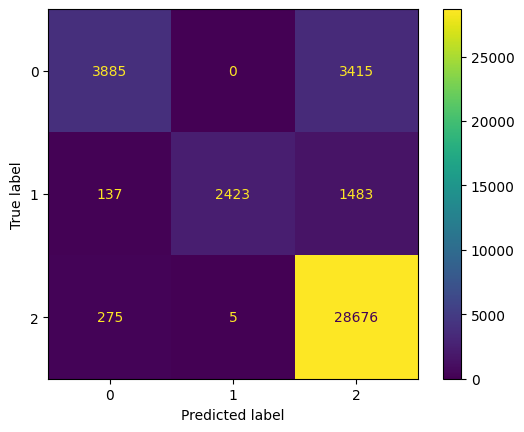

Cross Validation Scores are [0.85483356 0.8677018  0.86695735 0.86493672 0.87195576 0.86493672
 0.86344784 0.86812719 0.86938949 0.87375027]
Average Cross Validation score :0.8666036705281026
Mean Square Error 0.4065857713590908
Accuracy 0.8681108712374996
Specificity 0.9187243822615775
Sensitivity 0.7072764606291452


In [20]:
from sklearn.ensemble import RandomForestClassifier
from sklearn import metrics
from sklearn.metrics import accuracy_score, f1_score, precision_score, recall_score, classification_report, confusion_matrix
from sklearn.model_selection import cross_val_score,KFold

#implementing Randomforest classifier along with Kfold cross validation technique

kfold=KFold(n_splits=10) #10-folds has been selected for cross validation

#Random forest classifier
randomforest = RandomForestClassifier(n_estimators=100)
score = cross_val_score(randomforest,X_train, y_train, cv=kfold)
#print(X_train,y_train)
randomforest.fit(X_train, y_train)

prediction = randomforest.predict(X_test) #making prediction on the validating data
#print(prediction)

cm_display, accuracy,  sensitivity, specificity, mse = Model_Evaluation(prediction) #model evalution
cm_display.plot()  #plotting confusion matrix
plt.show()

print("Cross Validation Scores are {}".format(score))
print("Average Cross Validation score :{}".format(score.mean()))
print('Mean Square Error', mse)
print('Accuracy', accuracy)
print('Specificity', specificity)
print('Sensitivity', sensitivity)

# Prediction on Unseen Data

In [21]:
#make a prediction on unseen predicting data
prediction =  randomforest.predict(predictingData)
print(prediction)

[1. 2. 2. ... 1. 2. 1.]


In [23]:
#adding predicting labels into unseen testing data frame for compersion
result=predictingData.copy()
pred=pd.DataFrame(prediction)
#result
id=np.array(predict['id'])
df=pd.DataFrame(id)
result['id']=df[0]
duration=np.array(predict['Duration'])
label=np.array(predictingLabel)
df=pd.DataFrame(duration)
result['Duration']=pd.to_timedelta(df[0]).dt.total_seconds()/60
df=pd.DataFrame(label)
result['Label']=df[0]
result['Prediction']=pred
result
#predictingLabel
result.to_csv(os.path.join(PATH, 'result.csv'),index=False)

# Time Series Comparsion of  Actual Label Vs Predicting Labels 

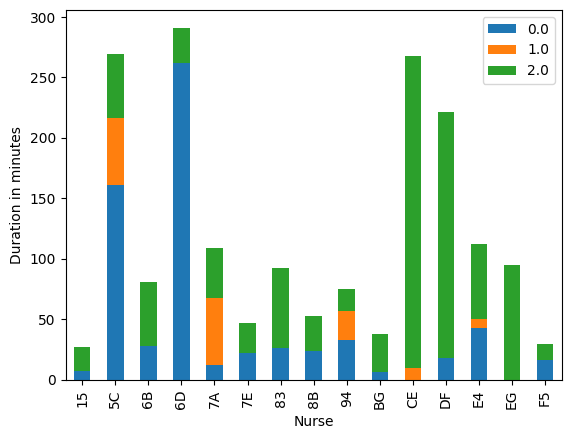

In [24]:
#gerating timeseries plt for duration vs actual labels
x=result['id']
y=result['Duration']
z=result['Label'] 

df=pd.concat([x,y,z], axis=1)
grouped = df.groupby(["id", "Label"]).mean().reset_index()

pivoted = grouped.pivot(index="id", columns="Label", values="Duration")

pivoted.plot(kind="bar", stacked=True)

plt.xlabel("Nurse")
plt.ylabel("Duration in minutes")

# Add a legend
plt.legend()

plt.show()

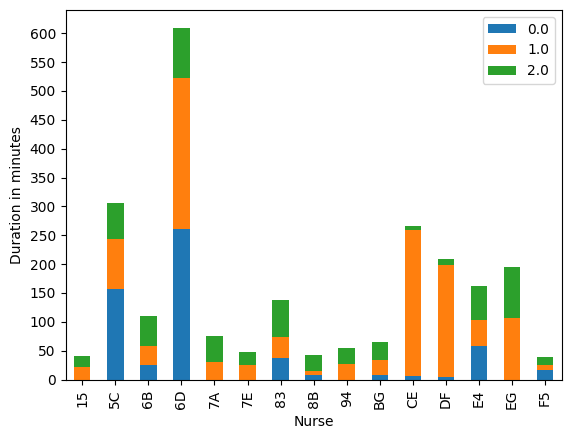

In [105]:
#gerating timeseries plt for duration vs predicting labels
x=result['id']
y=result['Duration']
z=result['Prediction'] 

df=pd.concat([x,y,z], axis=1)
grouped = df.groupby(["id", "Prediction"]).mean().reset_index()

pivoted = grouped.pivot(index="id", columns="Prediction", values="Duration")

pivoted.plot(kind="bar", stacked=True)

plt.xlabel("Nurse")

plt.ylabel("Duration in minutes")
plt.yticks(range(0,650,50))
# Add a legend
plt.legend()

plt.show()

# Change point evaluation against Duration

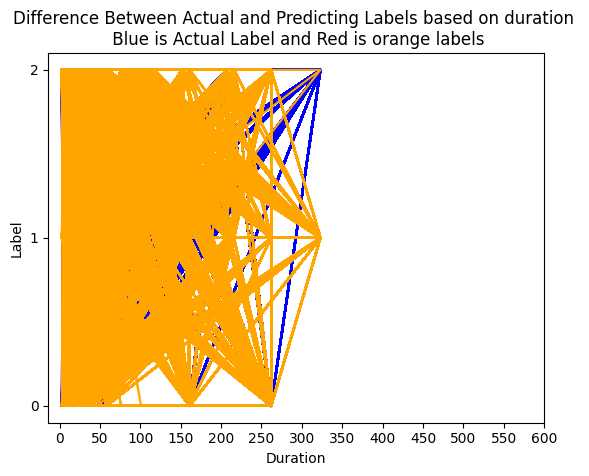

In [41]:
#make a graph for unseen testing data prediction and actual stress levels 
plt.rcParams['agg.path.chunksize'] = 10000
fig, ax = plt.subplots()

# Create the plot

ax.plot(result['Duration'],result['Label'], color='blue',label='Actual Label')
ax.plot(result['Duration'],result['Prediction'], color='orange',label='Predicting Label')

ax.set_title('Difference Between Actual and Predicting Labels based on duration \n Blue is Actual Label and Red is orange labels')
ax.set_xlabel('Duration')
ax.set_ylabel('Label')
ax.set_xticks(range(0,650,50))
ax.set_yticks(range(0,3,1))

plt.show()

